In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px 

##############################################################
# Preprocessing library
from sklearn.preprocessing import LabelEncoder,PolynomialFeatures,StandardScaler,RobustScaler,MinMaxScaler,OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score,confusion_matrix,accuracy_score,classification_report
from sklearn.decomposition import PCA
####################################################################
# Sampling library
from imblearn.combine import SMOTEENN
from collections import Counter
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import RandomOverSampler
###################################################################
# Algorithm Library
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
import xgboost as xgb
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
import pickle

In [2]:
# color schema for visualizion 
colors10 = ['#387478', '#4682B4', '#32CD32', '#FFD700','#001F3F','#B17457','#F2E5BF','#DA8359','#FFD09B','#A66E38']  # You can define your own colors
blue_1=['#2D4356', '#435B66', '#A76F6F', '#EAB2A0']
blue_2=['#0C134F', '#1D267D', '#2D4263', '#347474']
green1=['#1A1A19', '#31511E', '#859F3D', '#88C273']
brown1=['#A79277', '#D1BB9E', '#EAD8C0', '#FFF2E1']
yel_gre1=['#F3CA52', '#F6E9B2', '#0A6847', '#7ABA78']
red_tel=['#C96868', '#FADFA1', '#FFF4EA', '#7EACB5']
cofee=['#EAC696', '#C8AE7D', '#765827', '#65451F']
pastel=['#B5C0D0', '#CCD3CA', '#B4B4B8', '#B3A398']
retro=['#060047', '#B3005E', '#E90064', '#FF5F9E']
white_blue=['#04009A', '#77ACF1', '#77ACF1', '#C0FEFC']
cold_blue=['#240750', '#344C64', '#577B8D', '#57A6A1']
cold_green=['#006769', '#40A578', '#9DDE8B', '#E6FF94']
happy=['#D2E0FB', '#F9F3CC', '#D7E5CA', '#8EACCD']
sky=['#00A9FF', '#89CFF3', '#A0E9FF', '#CDF5FD']
grad_brown=['#8D7B68', '#A4907C', '#C8B6A6', '#F1DEC9']
grad_black=['#2C3333', '#2E4F4F', '#0E8388', '#CBE4DE']
grad_green=['#439A97', '#62B6B7', '#97DECE', '#CBEDD5']
grad_blue=['#164863', '#427D9D', '#9BBEC8', '#DDF2FD']
night=['#003C43', '#135D66', '#77B0AA', '#E3FEF7']


<p style="font-size:30px; color:green; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>Data Understanding</b>
 </p>

# Import the date

In [3]:
file_path = '/kaggle/input/loan-prediction/Loan approval prediction.csv'
df = pd.read_csv(file_path)
print(df.head())

   id  person_age  person_income person_home_ownership  person_emp_length  \
0   0          37          35000                  RENT                  0   
1   1          22          56000                   OWN                  6   
2   2          29          28800                   OWN                  8   
3   3          30          70000                  RENT                 14   
4   4          22          60000                  RENT                  2   

  loan_intent loan_grade  loan_amnt  loan_int_rate  loan_percent_income  \
0   EDUCATION          B       6000          11.49                 0.17   
1     MEDICAL          C       4000          13.35                 0.07   
2    PERSONAL          A       6000           8.90                 0.21   
3     VENTURE          B      12000          11.11                 0.17   
4     MEDICAL          A       6000           6.92                 0.10   

  cb_person_default_on_file  cb_person_cred_hist_length  loan_status  
0              

In [4]:
df.head()

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
0,0,37,35000,RENT,0,EDUCATION,B,6000,11.49,0.17,N,14,0
1,1,22,56000,OWN,6,MEDICAL,C,4000,13.35,0.07,N,2,0
2,2,29,28800,OWN,8,PERSONAL,A,6000,8.90,0.21,N,10,0
3,3,30,70000,RENT,14,VENTURE,B,12000,11.11,0.17,N,5,0
4,4,22,60000,RENT,2,MEDICAL,A,6000,6.92,0.10,N,3,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58645 entries, 0 to 58644
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          58645 non-null  int64  
 1   person_age                  58645 non-null  int64  
 2   person_income               58645 non-null  int64  
 3   person_home_ownership       58645 non-null  object 
 4   person_emp_length           58645 non-null  int64  
 5   loan_intent                 58645 non-null  object 
 6   loan_grade                  58645 non-null  object 
 7   loan_amnt                   58645 non-null  int64  
 8   loan_int_rate               58645 non-null  float64
 9   loan_percent_income         58645 non-null  float64
 10  cb_person_default_on_file   58645 non-null  object 
 11  cb_person_cred_hist_length  58645 non-null  int64  
 12  loan_status                 58645 non-null  int64  
dtypes: float64(2), int64(7), object

<p align="center" style="font-size:20px; color:#1A1A19; background-color:#697565; padding:10px; border-radius:5px;">
    The dataset contains loan approval prediction data with 58,645 rows and 13 columns. Here’s a description of each column: <br></br>
    id: Unique identifier for each loan application.<br></br>
    person_age: Age of the loan applicant.<br></br>
    person_income: Annual income of the applicant.<br></br>
    person_home_ownership: Homeownership status (e.g., RENT, OWN).<br></br>
    person_emp_length: Number of years of employment experience.<br></br>
    loan_intent: Purpose of the loan (e.g., EDUCATION, MEDICAL, PERSONAL, VENTURE).<br></br>
    loan_grade: Loan grade representing the risk level.<br></br>
    loan_amnt: Requested loan amount.<br></br>
    loan_int_rate: Interest rate on the loan.<br></br>
    loan_percent_income: Ratio of the loan amount to the applicant’s income.<br></br>
    cb_person_default_on_file: Whether the person has a history of defaults ("Y" for yes, "N" for no).<br></br>
    cb_person_cred_hist_length: Length of the applicant’s credit history in years.<br></br>
    loan_status: Loan status (0 for rejected, 1 for approved).<br></br>
</p>

# Data Cleaning 

In [6]:
# Check if the data has missing value or not 
# there is no missing value 
df.isnull().sum()

id                            0
person_age                    0
person_income                 0
person_home_ownership         0
person_emp_length             0
loan_intent                   0
loan_grade                    0
loan_amnt                     0
loan_int_rate                 0
loan_percent_income           0
cb_person_default_on_file     0
cb_person_cred_hist_length    0
loan_status                   0
dtype: int64

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,58645.0,29322.000000,16929.497605,0.00,14661.00,29322.00,43983.00,58644.00
person_age,58645.0,27.550857,6.033216,20.00,23.00,26.00,30.00,123.00
person_income,58645.0,64046.172871,37931.106978,4200.00,42000.00,58000.00,75600.00,1900000.00
person_emp_length,58645.0,4.701015,3.959784,0.00,2.00,4.00,7.00,123.00
loan_amnt,58645.0,9217.556518,5563.807384,500.00,5000.00,8000.00,12000.00,35000.00
loan_int_rate,58645.0,10.677874,3.034697,5.42,7.88,10.75,12.99,23.22
loan_percent_income,58645.0,0.159238,0.091692,0.00,0.09,0.14,0.21,0.83
cb_person_cred_hist_length,58645.0,5.813556,4.029196,2.00,3.00,4.00,8.00,30.00
loan_status,58645.0,0.142382,0.349445,0.00,0.00,0.00,0.00,1.00


<p align="center" style="font-size:20px; color:#1A1A19; background-color:#697565; padding:10px; border-radius:5px;">
    From the describtion it semms that : <br></br>
    person_age has outliers and right skewness ( meran > median).<br></br>
    person_income has high outliers and right skewness ( meran > median).<br></br>
    person_emp_length has small outliers and right skewness ( meran > median).<br></br>
    loan_amnt has high outliers and right skewness ( meran > median).<br></br>
    loan_int_rate has samll outliers and left skewness ( meran < median).<br></br>
    loan_percent_income	 has outliers and right skewness ( meran < median).<br></br>
</p>    

In [8]:
df[df['person_age']==123]

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
47336,47336,123,36000,MORTGAGE,7,PERSONAL,B,6700,10.75,0.18,N,4,0


In [9]:
# show the max value of the Number of years of employment experiencein the data , it displays as data entry error as the person age is less than the 123 
df[df['person_emp_length']==123]

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
41079,41079,28,60350,MORTGAGE,123,MEDICAL,D,25000,15.95,0.35,Y,6,1
49252,49252,21,192000,MORTGAGE,123,VENTURE,B,20000,11.49,0.10,N,2,0


<p align="center" style="font-size:20px; color:#508C9B; background-color:#40534C; padding:10px; border-radius:5px;">
    isnights : <br></br>
    person_age has max age is 123 and has number of years experices which is 7 ! , so it' a wrong data entry .<br></br>
    person_emp_length has number of years experices is 123 but their ages are 28 , 21 ,so it' a wrong data entry .<br></br>

</p>    

In [10]:
# determine the row that has the person age is 123
index_to_drop = df[df['person_age'] == 123].index

# Delete the row who has age 123 
df = df.drop(index_to_drop)

In [11]:
# determine the row that has the person_emp_length is 123
index_to_drop = df[df['person_emp_length'] == 123].index

# Delete the row who has age 123 
df = df.drop(index_to_drop)


In [12]:
df[df['loan_status']==1]

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
11,11,22,33000,RENT,6,PERSONAL,B,10000,11.12,0.30,N,2,1
24,24,22,30000,RENT,3,MEDICAL,D,5000,16.49,0.17,N,4,1
25,25,25,25000,RENT,3,VENTURE,C,3500,13.49,0.14,Y,3,1
38,38,30,54000,RENT,0,MEDICAL,B,12500,11.71,0.24,N,10,1
39,39,22,32000,RENT,6,EDUCATION,D,8000,15.58,0.25,N,3,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
58632,58632,23,29654,RENT,1,VENTURE,A,10000,6.54,0.34,N,2,1
58635,58635,32,69000,RENT,0,DEBTCONSOLIDATION,B,12000,10.20,0.17,N,7,1
58638,58638,29,46610,MORTGAGE,1,PERSONAL,D,2600,17.58,0.05,N,6,1
58641,58641,28,28800,RENT,0,MEDICAL,C,10000,12.73,0.35,N,8,1


In [13]:
df[df['loan_status']==0]

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
0,0,37,35000,RENT,0,EDUCATION,B,6000,11.49,0.17,N,14,0
1,1,22,56000,OWN,6,MEDICAL,C,4000,13.35,0.07,N,2,0
2,2,29,28800,OWN,8,PERSONAL,A,6000,8.90,0.21,N,10,0
3,3,30,70000,RENT,14,VENTURE,B,12000,11.11,0.17,N,5,0
4,4,22,60000,RENT,2,MEDICAL,A,6000,6.92,0.10,N,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
58637,58637,24,75000,RENT,8,VENTURE,B,4000,10.75,0.05,N,4,0
58639,58639,22,70000,RENT,6,DEBTCONSOLIDATION,A,10000,7.29,0.14,N,4,0
58640,58640,34,120000,MORTGAGE,5,EDUCATION,D,25000,15.95,0.21,Y,10,0
58643,58643,22,30000,RENT,2,EDUCATION,A,5000,8.90,0.17,N,3,0


In [14]:
df.describe(include='object').T

,count,unique,top,freq
person_home_ownership,58642,4,RENT,30594
loan_intent,58642,6,EDUCATION,12271
loan_grade,58642,7,A,20984
cb_person_default_on_file,58642,2,N,49941


# Exploratory Data Analysis (EDA)

In [15]:
df.columns

Index(['id', 'person_age', 'person_income', 'person_home_ownership',
       'person_emp_length', 'loan_intent', 'loan_grade', 'loan_amnt',
       'loan_int_rate', 'loan_percent_income', 'cb_person_default_on_file',
       'cb_person_cred_hist_length', 'loan_status'],
      dtype='object')

In [16]:
# Create the scatter plot to display the Age of the loan applicant 
fig = px.scatter(df['person_age'].value_counts().reset_index(), 
                 x='person_age',y='count',
                 color='person_age', color_discrete_sequence=yel_gre1)

# Update layout for title
fig.update_layout( title="Age of the loan applicant",  title_x=0.5, title_font=dict(size=20))

# Annotate mean, min, and max values
fig.add_annotation( x=df['person_age'].mean(), y=0, text=f"Mean: {df['person_age'].mean():.2f}", showarrow=True, arrowhead=2, ax=0, ay=-50, font=dict(size=12, color="blue") )
fig.add_annotation(x=df['person_age'].min(), y=0, text=f"Min: {df['person_age'].min()}",showarrow=True, arrowhead=2, ax=0, ay=-50,font=dict(size=12, color="green"))
fig.add_annotation(x=df['person_age'].max(), text=f"Max: {df['person_age'].max()}",showarrow=True, arrowhead=2, ax=0, ay=-50,font=dict(size=12, color="red"))

In [17]:
# Create the scatter plot to display the Annual income of the applicant.
fig = px.scatter(df['person_income'].value_counts().reset_index(), 
                 x='person_income', y='count', 
                 color='person_income', color_discrete_sequence=yel_gre1)

# Update layout for title
fig.update_layout(
    title=" Annual income of the applicant.",
    title_x=0.5,
    title_font=dict(size=20)
)

# Annotate mean, min, and max values
fig.add_annotation(
    x=df['person_income'].mean(), y=0, text=f"Mean: {df['person_income'].mean():.2f}",
    showarrow=True, arrowhead=2, ax=0, ay=-150,
    font=dict(size=14, color="blue")
)
fig.add_annotation(
    x=df['person_income'].min(), y=0, text=f"Min: {df['person_income'].min()}",
    showarrow=True, arrowhead=2, ax=0, ay=-100,
    font=dict(size=12, color="green")
)
fig.add_annotation(
    x=df['person_income'].max(), text=f"Max: {df['person_income'].max()}",
    showarrow=True, arrowhead=2, ax=0, ay=-100,
    font=dict(size=12, color="red")
)

In [18]:
# Create the pie chart for Homeownership status
fig = px.pie(
    df['person_home_ownership'].value_counts().reset_index(),
    names='person_home_ownership',  # Set regions as labels
    values='count',  # Set count as the value for each slice
    color='person_home_ownership'
)

# Update layout for title
fig.update_layout(
    title="Homeownership status",
    title_x=0.5,
    title_font=dict(size=20)
)

# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+percent+value', hole=0.4)

fig.show()


In [19]:
# Create the scatter plot for Number of years of employment experience
fig = px.scatter(df['person_emp_length'].value_counts().reset_index(), 
                 x='person_emp_length', y='count', 
                 color='person_emp_length', color_discrete_sequence=yel_gre1)

# Update layout for title
fig.update_layout(
    title="Number of years of employment experience.",
    title_x=0.5,
    title_font=dict(size=20)
)

# Annotate mean, min, and max values
fig.add_annotation(
    x=df['person_emp_length'].mean(), y=0, text=f"Mean: {df['person_emp_length'].mean():.2f}",
    showarrow=True, arrowhead=2, ax=20, ay=-40,
    font=dict(size=12, color="black")
)
fig.add_annotation(
    x=df['person_emp_length'].min(), y=0, text=f"Min: {df['person_emp_length'].min()}",
    showarrow=True, arrowhead=2, ax=20, ay=-40,
    font=dict(size=12, color="green")
)
fig.add_annotation(
    x=df['person_emp_length'].max(), text=f"Max: {df['person_emp_length'].max()}",
    showarrow=True, arrowhead=2, ax=20, ay=-40,
    font=dict(size=12, color="red")
)


In [20]:
# Create the histogram plot for Purpose of the loan
fig = px.histogram(df['loan_intent'].value_counts().reset_index(), 
                 x='loan_intent', y='count', 
                 color='loan_intent', color_discrete_sequence=colors10)

# Update layout for title
fig.update_layout(
    title="Purpose of the loan",
    title_x=0.5,
    title_font=dict(size=20)
)

In [21]:
# Create the pie chart for Loan grade representing the risk level
fig = px.pie(
    df['loan_grade'].value_counts().reset_index(),
    names='loan_grade',  # Set regions as labels
    values='count',  # Set count as the value for each slice
    color='loan_grade')

# Update layout for title
fig.update_layout(
    title="Loan grade representing the risk level.",
    title_x=0.5,
    title_font=dict(size=20)
)

# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+value', hole=0.4)

In [22]:
# Create the scatter plot for Requested loan amount
fig = px.scatter(df['loan_amnt'].value_counts().reset_index(), 
                 x='loan_amnt', y='count', 
                 color='loan_amnt', color_discrete_sequence=yel_gre1)

# Update layout for title
fig.update_layout(
    title="Requested loan amount",
    title_x=0.5,
    title_font=dict(size=20)
)

# Annotate mean, min, and max values
fig.add_annotation(
    x=df['loan_amnt'].mean(), y=0, text=f"Mean: {df['loan_amnt'].mean():.2f}",
    showarrow=True, arrowhead=2, ax=20, ay=-40,
    font=dict(size=12, color="black")
)
fig.add_annotation(
    x=df['loan_amnt'].min(), y=0, text=f"Min: {df['loan_amnt'].min()}",
    showarrow=True, arrowhead=2, ax=20, ay=-40,
    font=dict(size=12, color="green")
)
fig.add_annotation(
    x=df['loan_amnt'].max(), text=f"Max: {df['loan_amnt'].max()}",
    showarrow=True, arrowhead=2, ax=20, ay=-40,
    font=dict(size=12, color="red")
)



In [23]:
# Create the scatter plot for Interest rate on the loan
fig = px.scatter(df['loan_int_rate'].value_counts().reset_index(), 
                 x='loan_int_rate', y='count', 
                 color='loan_int_rate', color_discrete_sequence=yel_gre1)

# Update layout for title
fig.update_layout(
    title="Interest rate on the loan.",
    title_x=0.5,
    title_font=dict(size=20)
)

# Annotate mean, min, and max values
fig.add_annotation(
    x=df['loan_int_rate'].mean(), y=0, text=f"Mean: {df['loan_int_rate'].mean():.2f}",
    showarrow=True, arrowhead=2, ax=0, ay=-30,
    font=dict(size=12, color="black")
)
fig.add_annotation(
    x=df['loan_int_rate'].min(), y=0, text=f"Min: {df['loan_int_rate'].min()}",
    showarrow=True, arrowhead=2, ax=0, ay=-30,
    font=dict(size=12, color="green")
)
fig.add_annotation(
    x=df['loan_int_rate'].max(), y=0, text=f"Max: {df['loan_int_rate'].max()}",
    showarrow=True, arrowhead=2, ax=0, ay=-30,
    font=dict(size=12, color="red")
)


In [24]:
# Create the scatter plot for Ratio of the loan amount to the applicant’s income.
fig = px.scatter(df['loan_percent_income'].value_counts().reset_index(), 
                 x='loan_percent_income', y='count', 
                 color='loan_percent_income', color_discrete_sequence=yel_gre1)

# Update layout for title
fig.update_layout(
    title="Ratio of the loan amount to the applicant’s income.",
    title_x=0.5,
    title_font=dict(size=20)
)

# Annotate mean, min, and max values
fig.add_annotation(
    x=df['loan_percent_income'].mean(), y=0, text=f"Mean: {df['loan_percent_income'].mean():.2f}",
    showarrow=True, arrowhead=2, ax=10, ay=-40,
    font=dict(size=12, color="blue")
)
fig.add_annotation(
    x=df['loan_percent_income'].min(), y=0, text=f"Min: {df['loan_percent_income'].min()}",
    showarrow=True, arrowhead=2, ax=10, ay=-40,
    font=dict(size=12, color="green")
)
fig.add_annotation(
    x=df['loan_percent_income'].max(), y=0, text=f"Max: {df['loan_percent_income'].max()}",
    showarrow=True, arrowhead=2, ax=10, ay=-40,
    font=dict(size=12, color="red")
)



In [25]:
# Create the scatter plot for Length of the applicant’s credit history in years
fig = px.scatter(df['cb_person_cred_hist_length'].value_counts().reset_index(), 
                 x='cb_person_cred_hist_length', y='count', 
                 color='cb_person_cred_hist_length', color_discrete_sequence=yel_gre1)

# Update layout for title
fig.update_layout(
    title="Length of the applicant’s credit history in years.",
    title_x=0.5,
    title_font=dict(size=20)
)

# Annotate mean, min, and max values
fig.add_annotation(
    x=df['cb_person_cred_hist_length'].mean(), y=0, text=f"Mean: {df['cb_person_cred_hist_length'].mean():.2f}",
    showarrow=True, arrowhead=2, ax=0, ay=-30,
    font=dict(size=12, color="blue")
)
fig.add_annotation(
    x=df['cb_person_cred_hist_length'].min(), y=0, text=f"Min: {df['cb_person_cred_hist_length'].min()}",
    showarrow=True, arrowhead=2, ax=0, ay=-30,
    font=dict(size=12, color="green")
)
fig.add_annotation(
    x=df['cb_person_cred_hist_length'].max(), y=0, text=f"Max: {df['cb_person_cred_hist_length'].max()}",
    showarrow=True, arrowhead=2, ax=0, ay=-30,
    font=dict(size=12, color="red")
)



In [26]:
# Create the pie chart for Whether the person has a history of defaults.
fig = px.pie(
    df['cb_person_default_on_file'].value_counts().reset_index(),
    names='cb_person_default_on_file',  # Set regions as labels
    values='count',   # Set count as the value for each slice
    color='cb_person_default_on_file',
    color_discrete_sequence=cold_green
)

# Update layout for title
fig.update_layout(
    title="Whether the person has a history of defaults.",
    title_x=0.5,
    title_font=dict(size=20)
)


# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+percent+value', hole=0.4)


In [27]:
# Create the pie chart for Loan status (0 for rejected, 1 for approved)
fig = px.pie(
    df['loan_status'].value_counts().reset_index(),
    names='loan_status',  # Set regions as labels
    values='count',   # Set count as the value for each slice
    color='loan_status',
    color_discrete_sequence=sky
)

# Update layout for title
fig.update_layout(
    title="Loan status (0 for rejected, 1 for approved).",
    title_x=0.5,
    title_font=dict(size=20)
)
# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+percent+value', hole=0.4)

# Multidimension analysis

In [28]:
df.columns

Index(['id', 'person_age', 'person_income', 'person_home_ownership',
       'person_emp_length', 'loan_intent', 'loan_grade', 'loan_amnt',
       'loan_int_rate', 'loan_percent_income', 'cb_person_default_on_file',
       'cb_person_cred_hist_length', 'loan_status'],
      dtype='object')

In [29]:
# Create Scater plot between Applicant's Income vs Age with Loan Status as Bubble Siz
fig = px.scatter(
    df,
    x='person_age',
    y='person_income',
    size='person_income',  # Bubble size based on credit history length
    color='loan_status',
    color_continuous_scale='Viridis',  # Use a continuous color scale for better gradient
    title="Applicant's Income vs Age with Loan Status as Bubble Size"
)
# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20)
)
fig.show()


<p>
    <div style="text-align:left; font-size:18px; color:#000000; background-color:#77ACF1; padding:15px; border-radius:8px; border:1px solid #04009A;">
        The most common age range with higher income is between 22 and 50 years old.<br><br>
        Applicants aged between 22 and 35 tend to have incomes greater than 500k.   
    </div>
    <div style="text-align:left; font-size:18px; color:yellow; background-color:#77ACF1; padding:15px; border-radius:8px; border:1px solid #04009A;">
        we notice that the accepted loans mostly for the age between 22 and 60 and it doesn't depend on the higher income at all ,the max income has accepted loan is 379k however the the applicant has more than 1M income hasn't accepted
    </div>
</p>


In [30]:

# Create a Pie chart between loan_status and loan_amount
fig = px.pie(df, names='loan_status', values='loan_amnt')

# Update the layout with title and styling
fig.update_layout(
    title="Loan Status vs Loan Amount",
    title_x=0.5,
    title_font=dict(size=20)
)
# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+percent+value', hole=0.4)

# Show the plot
fig.show()


<p align="center" style="font-size:20px; color:#000000; background-color:#77ACF1; padding:10px; border-radius:5px;">
        <b>the loan amount of The Accepted Loan is 93M with 17.3% out of the total.</b><br><br>
        <b>the loan amount of The rejected Loan is 447M with 82.7% out of the total.</b> <br><br>
         <div style="text-align:center; font-size:20px; color:yellow; background-color:black; padding:15px; border-radius:8px; border:1px solid #04009A;">
                <b> So Most of the Applicant Loans is rejected </b>
        </div>
</p>


In [31]:
# Create Scater plot between Applicant's Income vs loan_amount with loan_status 
fig = px.scatter(
    df,
    x='loan_amnt',
    y='person_income',
    size='loan_amnt',  # Bubble size based on credit history length
    color='loan_status',
    color_continuous_scale='Plasma',  # Use a continuous color scale for better gradient
    title="Applicant's Income vs loan_amount with loan_status as Bubble Size"
)
# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20)
)
fig.show()



<p align="center" style="font-size:20px; color:#00A9FF; background-color:#164863; padding:10px; border-radius:5px;">
        <b>most of approval loan amount between 15k and 30k and the applicant has less income .</b>
</p>


In [32]:
# Create Scater plot between Applicant's loan_amnt vs Age with Loan Status
fig = px.scatter(
    df,
    x='person_age',
    y='loan_amnt',
    size='loan_amnt',  # Bubble size based on credit history length
    color='loan_status',
    color_continuous_scale='Viridis',  # Use a continuous color scale for better gradient
    title="Applicant's loan_amount vs Age with Loan Status as Bubble Size"
)

# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20)
)

fig.show()


<p align="center" style="font-size:20px; color:#9EDF9C; background-color:#164863; padding:10px; border-radius:5px;">
        <b>most of approval loan amount between 15k and 30k and the applicant has ages between 22 to 60.</b>
</p>


In [33]:
# Create Scater plot between Applicant's person_emp_length vs Age with Loan Status
fig = px.scatter(
    df,
    x='person_age',
    y='person_emp_length',
    size='person_emp_length',  # Bubble size based on credit history length
    color='loan_status',
    color_continuous_scale='Plasma',  # Use a continuous color scale for better gradient
    title="Applicant's person_emp_length vs Age with Loan Status as Bubble Size"
)

# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20)
)
fig.show()


<p align="center" style="font-size:20px; color:red; background-color:#black; padding:10px; border-radius:5px;">
        <b>there are inconsistencies in the relationship between a person's age (person_age) and their years of employment (person_emp_length).</b>
</p>


In [34]:
# Create Scater plot between Applicant's cb_person_cred_hist_length vs Age with Loan Status
fig = px.scatter(
    df,
    x='person_age',
    y='cb_person_cred_hist_length',
    size='cb_person_cred_hist_length',  # Bubble size based on credit history length
    color='loan_status',
    color_continuous_scale='Viridis',  # Use a continuous color scale for better gradient
    title="Applicant's cb_person_cred_hist_length vs Age with Loan Status as Bubble Size"
)
# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20)
)
fig.show()


<p align="center" style="font-size:20px; color:#181C14; background-color:#6CBEC7; padding:10px; border-radius:5px;">
        <b>there is a positive strong relationship between age and the Length of the applicant’s credit history in years.</b>
</p>


In [35]:
fig = px.treemap(
    df,
    path=['person_home_ownership', 'loan_intent', 'loan_grade', 'cb_person_default_on_file'],
    values='loan_amnt',
    color='loan_amnt',  # Use loan amount for a gradient effect
    color_continuous_scale='Viridis',  # Choose a visually appealing color scale
    title="Loan Amount Distribution by Home Ownership, Loan Intent, Loan Grade, and Default Status"
)

# Update layout for a centered title, background, and padding
fig.update_layout(
    title={
        'text': "Loan Amount Distribution by Home Ownership, Loan Intent, Loan Grade, and Default Status",
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top',
        'font': dict(size=22, color='black')
    },
    margin=dict(t=50, l=25, r=25, b=25),
    paper_bgcolor="white"  # Set background color to white for a cleaner look
)

# Customize the hover info for clarity
fig.update_traces(
    textinfo="label+value+percent root",  # Show label, value, and percentage of the root level
    hovertemplate="<b>%{label}</b><br>Loan Amount: %{value}<br>Percentage of Total: %{percentRoot:.2%}"
)
fig.show()


<p align="center" style="font-size:20px; color:#CBDCEB; background-color:#526D82; padding:10px; border-radius:5px;">
        <b>it seems that in higher loan grade in any home ownership the person doesn't have a history of defaults so the most is paying on time .</b> <br></br>
        <b>most of the loan reasons is for Education and for peopple has rent and Mortgage home while in Own and Other place in the second phase so most of the people who pay for living need loan for education and asking for high loan amount.</b> <br></br>
        <b>most of the Medical loans has second place for rent and the last choise for mortgage and other and at the 4th place for own home  .</b> <br></br>
        <b>most of the Venture loans has 1st place for own ,other and the last choise for rent and other and at the 3th place for mortgage home  .</b> <br></br>

</p>

In [36]:
# Create a Pie chart between loan_intent and loan_amnt
fig = px.pie(df, names='loan_intent', values='loan_amnt')

# Update the layout with title and styling
fig.update_layout(
    title="loan_intent with the loan amount",
    title_x=0.5,
    title_font=dict(size=20)
)
# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+percent+value', hole=0.4)

# Show the plot
fig.show()

In [37]:
fig = px.box(
    data_frame=df,
    x='loan_grade',
    y='loan_int_rate',
    color='loan_status',
    color_discrete_sequence=['red', 'green'],
    title="Applicant's Interest Rate by loan_grade"
)

# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20),
    xaxis_title="Loan Status (0 = Rejected, 1 = Approved)",
    yaxis_title="Interest Rate (%)"
)

# Display the plot
fig.show()

In [38]:
fig = px.treemap(
    df, 
    path=['person_home_ownership', 'loan_intent', 'loan_grade'], 
    values='person_income',
    color='person_income',  # Use loan_int_rate for a gradient color
    color_continuous_scale='Viridis',  # Choose a visually pleasing continuous color scale
    title="person_income  by Home Ownership, Loan Intent, and Grade"
)

# Update layout for a cleaner and more readable design
fig.update_layout(title={ 'text': "person_income by Home Ownership, Loan Intent, and Grade",  'x': 0.5,'xanchor': 'center','yanchor': 'top','font': dict(size=22, color='black') } # Center and customize title font  
  ,  margin=dict(t=50, l=25, r=25, b=25),  # Add padding for clarity
    paper_bgcolor="white"  # Set background color to white
)

# Update trace for better hover information
fig.update_traces(
    textinfo="label+percent entry+value",  # Display label, percentage, and value
    hovertemplate="<b>%{label}</b><br>person_income: %{value}<br>Percentage: %{percentEntry:.2%}"
)

fig.show()

In [39]:
# Create a Pie chart between person_home_ownership and loan_amnt
fig = px.pie(df, names='person_home_ownership', values='person_income',color_discrete_sequence=cofee)

# Update the layout with title and styling
fig.update_layout(
    title="person_home_ownership with the person_income",
    title_x=0.5,
    title_font=dict(size=20)
)
# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+percent+value', hole=0.3)

<p align="center" style="font-size:20px; color:#201E43; background-color:#227B94; padding:10px; border-radius:5px;">
        <b>Mortgage home Has higher Income , Rent home is the 2nd one and the Own home is the 3rd .</b>
</p>

In [40]:
# Create the histogram plot for person_home_ownership and loan_amnt
fig = px.histogram(df, 
                 x='person_home_ownership', y='loan_amnt', 
                 color='person_home_ownership', color_discrete_sequence=colors10)

# Update layout for title
fig.update_layout(
    title="person_home_ownership and loan_amnt ",
    title_x=0.5,
    title_font=dict(size=20)
)

In [41]:
df.columns

Index(['id', 'person_age', 'person_income', 'person_home_ownership',
       'person_emp_length', 'loan_intent', 'loan_grade', 'loan_amnt',
       'loan_int_rate', 'loan_percent_income', 'cb_person_default_on_file',
       'cb_person_cred_hist_length', 'loan_status'],
      dtype='object')

In [42]:
fig = px.box(
    data_frame=df,
    x='loan_status',
    y='loan_percent_income',
    color='loan_status',
    color_discrete_sequence=['red', 'green'],
    title="Applicant's loan_percent_income by Loan Status"
)

# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20),
    xaxis_title="Loan Status (0 = Rejected, 1 = Approved)",
    yaxis_title="loan_percent_income(%)"
)

# Display the plot
fig.show()

In [43]:
fig = px.box(
    data_frame=df,
    x='loan_status',
    y='loan_int_rate',
    color='loan_status',
    color_discrete_sequence=['red', 'green'],
    title="Applicant's Interest Rate by Loan Status"
)

# Update layout for title
fig.update_layout(
    title_x=0.5,
    title_font=dict(size=20),
    xaxis_title="Loan Status (0 = Rejected, 1 = Approved)",
    yaxis_title="Interest Rate (%)"
)

# Display the plot
fig.show()

<div style="background-color:#EAF2F8; padding:20px; border-radius:8px; border:1px solid #2980B9; font-size:20px;">
    <p align="center" style="color:#2C3E50; font-weight:bold; font-size:22px;">💡 Insights from the Visualization:</p>
    <!-- Insight 1 -->
    <div style="background-color:#D6EAF8; padding:15px; border-radius:8px; margin-bottom:15px;">
        <p style="font-size:18px; color:#2C3E50;">
            The most common age range with higher income is between 22 and 40 years old.
        </p>
        <p style="font-size:18px; color:#2980B9;">
            Most accepted loans are for applicants aged 22-60, and high income does not guarantee loan acceptance.
        </p>
        <p style="font-size:18px; color:#2980B9;">  Applicants aged between 22 and 35 tend to have incomes greater than 500k.   </p>
        <p style="font-size:18px; color:#2980B9;">  the accepted loans mostly for the age between 22 and 60 ,the max income has accepted loan is 379k however the the applicant has more than 1M income hasn't accepted.   </p>
    </div>
 <!-- Loan Approval Insight -->
    <div style="background-color:#D6EAF8; padding:15px; border-radius:8px; margin-bottom:15px;">
        <p style="font-size:18px; color:#2C3E50;">
            <b>Accepted Loan Amount: 93M (17.3% of total)</b><br>
            <b>Rejected Loan Amount: 447M (82.7% of total)</b>
        </p>
        <p style="font-size:20px; color:#E74C3C; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>Most Applicant Loans are Rejected</b>
        </p>
    </div>
  <!-- Additional Insights -->
    <div style="background-color:#F9EBEA; padding:15px; border-radius:8px; margin-bottom:15px;">
        <p style="font-size:18px; color:#2C3E50;">
            Most approved loan amounts are between 15k and 30k, often for applicants with lower incomes or ages 22-60.
        </p>
    </div>
 <!-- Relationship between Age and Credit History -->
    <div style="background-color:#E8F8F5; padding:15px; border-radius:8px; margin-bottom:15px;">
        <p style="font-size:18px; color:#1A5276; text-align:center;">
            <b>Strong positive relationship observed between age and length of credit history.</b>
        </p>
    </div>
 <!-- Loan Intent and Home Ownership Insights -->
    <div style="background-color:#FEF5E7; padding:15px; border-radius:8px; color:#7D6608; margin-bottom:15px;">
        <p style="font-size:18px;">
            Higher loan grades correlate with applicants who have no default history and often pay on time.
        </p>
        <p style="font-size:18px;">
            Most loans are for education, especially for those renting or with mortgages, while homeowners often request loans for ventures.
        </p>
        <p style="font-size:18px;">
            Medical loans are primarily for renters, and venture loans are commonly requested by homeowners.
        </p>
    </div>
 <!-- Interest Rate and Loan Grade Insights -->
    <div style="background-color:#D1F2EB; padding:15px; border-radius:8px; margin-bottom:15px;">
        <p style="font-size:18px; color:#117A65; text-align:center;">
            Higher loan grades (higher risk) are associated with higher interest rates.
        </p>
    </div>
  <!-- Income by Home Ownership -->
    <div style="background-color:#EBEDEF; padding:15px; border-radius:8px; text-align:center;">
        <p style="font-size:18px; color:#5D6D7E;">
            Mortgage homeowners have the highest income, followed by renters, and then owners.
        </p>
    </div>
</div>


#
<p style="font-size:50px; color:#EEEEEE; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>Modeling</b>
 </p>


<p style="font-size:30px; color:green; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>Preprocessing</b>
 </p>

## Copy data

In [44]:
loan=df.copy()
loan.head()

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
0,0,37,35000,RENT,0,EDUCATION,B,6000,11.49,0.17,N,14,0
1,1,22,56000,OWN,6,MEDICAL,C,4000,13.35,0.07,N,2,0
2,2,29,28800,OWN,8,PERSONAL,A,6000,8.90,0.21,N,10,0
3,3,30,70000,RENT,14,VENTURE,B,12000,11.11,0.17,N,5,0
4,4,22,60000,RENT,2,MEDICAL,A,6000,6.92,0.10,N,3,0


# 

<p style="font-size:30px; color:brown; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>Encoding</b>
 </p>

In [45]:
label=LabelEncoder()

In [46]:
object_column=loan[['person_home_ownership','loan_intent','loan_grade','cb_person_default_on_file']]

In [47]:
for i in object_column:
    loan[i]=label.fit_transform(loan[i])

In [48]:
loan.head()

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
0,0,37,35000,3,0,1,1,6000,11.49,0.17,0,14,0
1,1,22,56000,2,6,3,2,4000,13.35,0.07,0,2,0
2,2,29,28800,2,8,4,0,6000,8.90,0.21,0,10,0
3,3,30,70000,3,14,5,1,12000,11.11,0.17,0,5,0
4,4,22,60000,3,2,3,0,6000,6.92,0.10,0,3,0


In [49]:
loan.info()

<class 'pandas.core.frame.DataFrame'>
Index: 58642 entries, 0 to 58644
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          58642 non-null  int64  
 1   person_age                  58642 non-null  int64  
 2   person_income               58642 non-null  int64  
 3   person_home_ownership       58642 non-null  int64  
 4   person_emp_length           58642 non-null  int64  
 5   loan_intent                 58642 non-null  int64  
 6   loan_grade                  58642 non-null  int64  
 7   loan_amnt                   58642 non-null  int64  
 8   loan_int_rate               58642 non-null  float64
 9   loan_percent_income         58642 non-null  float64
 10  cb_person_default_on_file   58642 non-null  int64  
 11  cb_person_cred_hist_length  58642 non-null  int64  
 12  loan_status                 58642 non-null  int64  
dtypes: float64(2), int64(11)
memory usag

# 

<p style="font-size:30px; color:red; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>Handling Outliers</b>
 </p>

# check the outliers 

In [50]:
px.box(loan)

In [51]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Create a subplot grid
fig = make_subplots(rows=1, cols=5, subplot_titles=["Person Income", "Person Age", "Employment Length", "Loan Interest Rate", "Loan Amount"])

# Add box plots for each column
fig.add_trace(go.Box(y=loan['person_income'], name="Person Income"), row=1, col=1)
fig.add_trace(go.Box(y=loan['person_age'], name="Person Age"), row=1, col=2)
fig.add_trace(go.Box(y=loan['person_emp_length'], name="Employment Length"), row=1, col=3)
fig.add_trace(go.Box(y=loan['loan_int_rate'], name="Loan Interest Rate"), row=1, col=4)
fig.add_trace(go.Box(y=loan['loan_amnt'], name="Loan Amount"), row=1, col=5)

# Update layout for better aesthetics
fig.update_layout(
    title_text="Box Plots of Loan Dataset Features",
    title_x=0.5,
    height=600,
    width=1400,
    showlegend=False,
    title_font=dict(size=20)
)

# Show the figure
fig.show()


<p style="font-size:30px; color:#CBD2A4; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>There are outliers in the data with person_income amounts exceeding 1,000,000 . </b>
</p>

<p style="font-size:30px; color:#CBD2A4; background-color:#006A67; padding:10px; border-radius:8px; text-align:center;">
            <b>There are outliers in the data with Number of person_age exceeding 80 years</b>
</p>

<p style="font-size:30px; color:#6A9AB0; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:left;">
            <b>There are outliers in the data with Number of years of employment experience exceeding 40 years </b>
</p>

<p style="font-size:30px; color:#CBD2A4; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>There are outliers in the data with loan amounts exceeding 35,000, indicating that a few individuals requested unusually high loans compared to others. </b>
</p>

<p style="font-size:30px; color:#CBD2A4; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>There is a small outliers in the data with loan_int_rate exceeding 20 . </b>
</p>

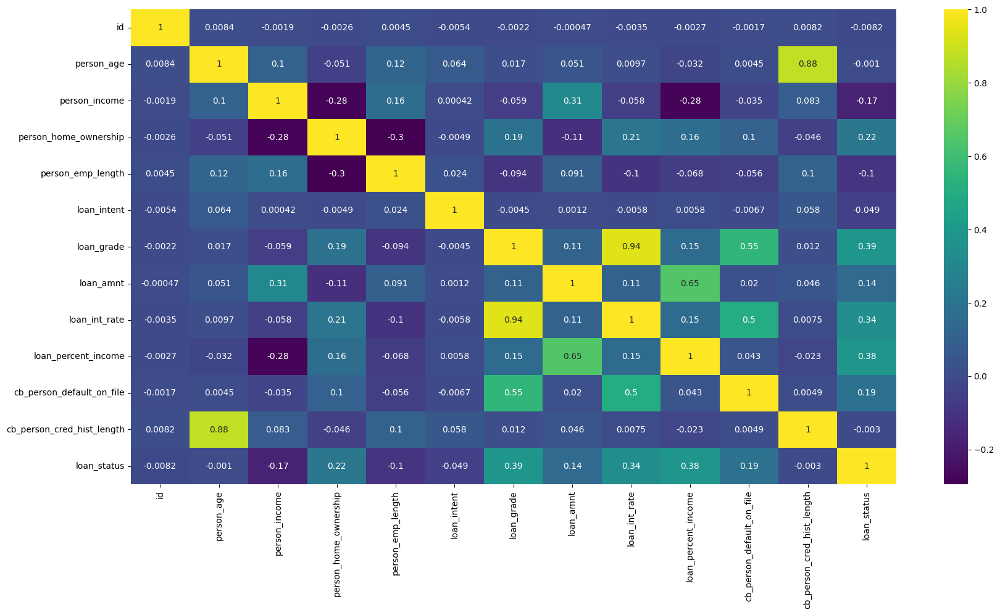

In [52]:
plt.figure(figsize=(20,10))
sns.heatmap(loan.corr(),annot=True,cmap='viridis')
plt.show()

# Handling if exist

In [53]:
loan.head()

,id,person_age,person_income,person_home_ownership,person_emp_length,loan_intent,loan_grade,loan_amnt,loan_int_rate,loan_percent_income,cb_person_default_on_file,cb_person_cred_hist_length,loan_status
0,0,37,35000,3,0,1,1,6000,11.49,0.17,0,14,0
1,1,22,56000,2,6,3,2,4000,13.35,0.07,0,2,0
2,2,29,28800,2,8,4,0,6000,8.90,0.21,0,10,0
3,3,30,70000,3,14,5,1,12000,11.11,0.17,0,5,0
4,4,22,60000,3,2,3,0,6000,6.92,0.10,0,3,0


In [54]:
# Convert 'cb_person_default_on_file' and 'loan_status' columns to integers
loan['cb_person_default_on_file'] = loan['cb_person_default_on_file'].astype(int)
loan['loan_status'] = loan['loan_status'].astype(int)

# 

<p style="font-size:30px; color:green; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b>   Model Selection  </b>
 </p>

# Spliting Data

In [55]:
X=loan.drop(['id','loan_status',"person_emp_length"],axis=1)
y=loan['loan_status']

In [56]:
# Create the pie chart for Loan status (0 for rejected, 1 for approved)
fig = px.pie(
    df['loan_status'].value_counts().reset_index(),
    names='loan_status',  # Set regions as labels
    values='count',   # Set count as the value for each slice
    color='loan_status',
    color_discrete_sequence=sky
)
# Update layout for title
fig.update_layout(
    title="Loan status (0 for rejected, 1 for approved).",
    title_x=0.5,
    title_font=dict(size=20)
)
# Show name, percentage, and value on each slice
fig.update_traces(textinfo='label+percent+value', hole=0.4)

# 

<p style="font-size:30px; color:green; background-color:#2C3E50; padding:10px; border-radius:8px; text-align:center;">
            <b> there is an imbalance as shown in the graph so we have to handle it  </b>
 </p>

# Combined (Hybrid) Sampling

In [57]:
# Combined (Hybrid) Sampling
from imblearn.combine import SMOTEENN

smote_enn = SMOTEENN(random_state=42)
X_combined, y_combined = smote_enn.fit_resample(X, y)

print(f"Original dataset shape: {Counter(y)}")
print(f"Combined SMOTEENN dataset shape: {Counter(y_combined)}")

Original dataset shape: Counter({0: 50293, 1: 8349})
Combined SMOTEENN dataset shape: Counter({1: 41229, 0: 39262})


In [58]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=42)

In [59]:
X_train,X_test,y_train,y_test=train_test_split(X_combined,y_combined,test_size=0.2,random_state=42)

# Scaling data

In [60]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# xgboost Alg

In [61]:
import xgboost as xgb
gb = xgb.XGBClassifier( n_estimators=600,learning_rate=0.08, gamma=0,subsample=0.75,colsample_bytree=1, max_depth=10)

In [62]:
gb.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              device=None, early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.08, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=10,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=600,
              n_jobs=None, num_parallel_tree=None, random_state=None, ...)

In [63]:
y_test_preds = gb.predict(X_test)

In [64]:
cm = confusion_matrix(y_test, y_test_preds)
print(cm)
accuracy_score(y_test, y_test_preds)

[[7748  143]
 [ 175 8033]]


0.9802472203242437

In [65]:
selected_features = ['person_age', 'person_income', 'person_home_ownership', 
                        'loan_intent', 'loan_amnt', 'person_emp_length']
X = loan[selected_features]

In [66]:
# Scale the selected features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

with open('scaler loan.pkl', 'wb') as f:
    pickle.dump(scaler, f)

# RandomForestClassifier ALG 

In [67]:
from sklearn.ensemble import RandomForestClassifier
classifier = RandomForestClassifier(n_estimators = 300, criterion = 'gini', random_state = 42)

In [68]:
classifier.fit(X_train, y_train)


RandomForestClassifier(n_estimators=300, random_state=42)

In [69]:
y_pred = classifier.predict(X_test)


In [70]:
from sklearn.metrics import confusion_matrix, accuracy_score
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred)


[[7610  281]
 [ 311 7897]]


0.9632275296602273

# DecisionTreeClassifier

In [71]:
from sklearn.tree import DecisionTreeClassifier
classifier1 = DecisionTreeClassifier(criterion = 'entropy',random_state = 42,max_depth=None,min_samples_leaf=1,min_samples_split=5)
classifier1.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', min_samples_split=5,
                       random_state=42)

In [72]:
y_pred_dec=classifier1.predict(X_test)

In [73]:
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred_dec)

[[7610  281]
 [ 311 7897]]


0.9508043977886825

# SVM ( poly )

In [74]:
from sklearn.svm import SVC
svc_model1 = SVC(kernel = 'poly', random_state = 42,C=2,degree=2)

In [75]:
svc_model1.fit(X_train,y_train)

SVC(C=2, degree=2, kernel='poly', random_state=42)

In [76]:
y_pred_svc1=svc_model1.predict(X_test)

In [77]:
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred_svc1)

[[7610  281]
 [ 311 7897]]


0.8470712466612833

# SVM ( rbf )

In [78]:
svc_model1 = SVC(kernel = 'rbf', random_state = 42,C=5)

In [79]:
svc_model1.fit(X_train,y_train)

SVC(C=5, random_state=42)

In [80]:
y_pred_svc1=svc_model1.predict(X_test)

In [81]:
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred_svc1)

[[7610  281]
 [ 311 7897]]


0.907696130194422

# SVM ( linear )

In [82]:
svc_model=SVC(C=5)

In [83]:
svc_model.fit(X_train,y_train)

SVC(C=5)

In [84]:
y_pred_svc=svc_model.predict(X_test)

In [85]:
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred_svc)

[[7610  281]
 [ 311 7897]]


0.907696130194422

# LogisticRegression

In [86]:
from sklearn.linear_model import LogisticRegression
log=LogisticRegression()
log.fit(X_train,y_train)

LogisticRegression()

In [87]:
y_pred_log=log.predict(X_test)

In [88]:
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred_log)

[[7610  281]
 [ 311 7897]]


0.8551462823777874

# KNeighborsClassifier

In [89]:
from sklearn.neighbors import KNeighborsClassifier
classifier = KNeighborsClassifier(n_neighbors = 1, metric = 'minkowski', p = 2)
classifier.fit(X_train, y_train)


KNeighborsClassifier(n_neighbors=1)

In [90]:

cm1= confusion_matrix(y_test, y_pred)
cm = confusion_matrix(y_test, y_pred, labels=classifier.classes_)
plt.show()

print(cm)
accuracy_score(y_test, y_pred)



[[7610  281]
 [ 311 7897]]


0.9632275296602273

In [91]:
test_error_rates = []

for k in range(1,20):
    knn_model = KNeighborsClassifier(n_neighbors=k)
    knn_model.fit(X_train,y_train) 
   
    y_pred_test = knn_model.predict(X_test)
    
    test_error = 1 - accuracy_score(y_test,y_pred_test)
    test_error_rates.append(test_error)

Text(0.5, 0, 'K Value')

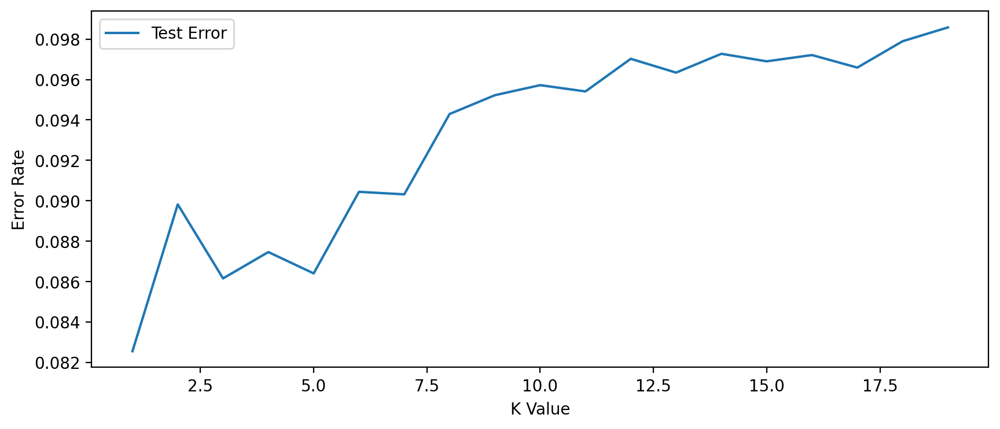

In [92]:
plt.figure(figsize=(10,4),dpi=200)
plt.plot(range(1,20),test_error_rates,label='Test Error')
plt.legend()
plt.ylabel('Error Rate')
plt.xlabel("K Value")